<a href="https://colab.research.google.com/github/freddy-irribarra/mysql/blob/main/062_tabla_pivote_condicional_y_crosotab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
pd.__version__
from zipfile import ZipFile
from io import BytesIO
from urllib.request import urlopen
url = urlopen  ('https://datosabiertos.salud.gob.mx/gobmx/salud/datos_abiertos/historicos/2020/COVID19MEXICO2020.zip')
zipfile = ZipFile(BytesIO(url.read()))
df = pd.read_csv(zipfile.open('COVID19MEXICO2020.csv'), encoding = "ISO-8859-1")

<ipython-input-1-02c13e668e57>:8: DtypeWarning: Columns (38) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(zipfile.open('COVID19MEXICO2020.csv'), encoding = "ISO-8859-1")


In [ ]:
len(df)

3868396

In [ ]:
df.shape

(3868396, 40)

In [ ]:
df.head(5)

,FECHA_ACTUALIZACION,ID_REGISTRO,ORIGEN,SECTOR,ENTIDAD_UM,SEXO,ENTIDAD_NAC,ENTIDAD_RES,MUNICIPIO_RES,TIPO_PACIENTE,...,OTRO_CASO,TOMA_MUESTRA_LAB,RESULTADO_LAB,TOMA_MUESTRA_ANTIGENO,RESULTADO_ANTIGENO,CLASIFICACION_FINAL,MIGRANTE,PAIS_NACIONALIDAD,PAIS_ORIGEN,UCI
0,2021-10-31,z4d6fe,1,6,24,1,24,24,28,1,...,2,1,1,2,97,3,99,MÃ©xico,97,97
1,2021-10-31,z2a3cf,1,6,24,2,24,24,28,1,...,1,2,97,2,97,6,99,MÃ©xico,97,97
2,2021-10-31,z1e370,1,12,14,1,14,14,85,1,...,2,1,2,2,97,7,99,MÃ©xico,97,97
3,2021-10-31,z3bf80,2,12,8,2,8,8,37,1,...,2,1,1,2,97,3,99,MÃ©xico,97,97
4,2021-10-31,zz7067,1,12,9,2,9,9,7,1,...,2,1,2,2,97,7,99,MÃ©xico,97,97


In [ ]:
df.tail(5)

,FECHA_ACTUALIZACION,ID_REGISTRO,ORIGEN,SECTOR,ENTIDAD_UM,SEXO,ENTIDAD_NAC,ENTIDAD_RES,MUNICIPIO_RES,TIPO_PACIENTE,...,OTRO_CASO,TOMA_MUESTRA_LAB,RESULTADO_LAB,TOMA_MUESTRA_ANTIGENO,RESULTADO_ANTIGENO,CLASIFICACION_FINAL,MIGRANTE,PAIS_NACIONALIDAD,PAIS_ORIGEN,UCI
3868391,2021-10-31,94d648,2,9,9,1,15,15,58,2,...,2,2,97,2,97,2,99,MÃ©xico,97,2
3868392,2021-10-31,bb6edb,2,9,9,2,15,15,25,2,...,1,2,97,2,97,2,99,MÃ©xico,97,2
3868393,2021-10-31,7d32d9,2,9,9,2,9,9,7,2,...,1,2,97,2,97,2,99,MÃ©xico,97,1
3868394,2021-10-31,660ba7,1,4,9,1,9,9,7,2,...,2,2,97,2,97,2,99,MÃ©xico,97,2
3868395,2021-10-31,52b2e6,2,4,9,2,9,15,57,2,...,2,2,97,2,97,2,99,MÃ©xico,97,2


In [ ]:
df.columns

Index(['FECHA_ACTUALIZACION', 'ID_REGISTRO', 'ORIGEN', 'SECTOR', 'ENTIDAD_UM',
       'SEXO', 'ENTIDAD_NAC', 'ENTIDAD_RES', 'MUNICIPIO_RES', 'TIPO_PACIENTE',
       'FECHA_INGRESO', 'FECHA_SINTOMAS', 'FECHA_DEF', 'INTUBADO', 'NEUMONIA',
       'EDAD', 'NACIONALIDAD', 'EMBARAZO', 'HABLA_LENGUA_INDIG', 'INDIGENA',
       'DIABETES', 'EPOC', 'ASMA', 'INMUSUPR', 'HIPERTENSION', 'OTRA_COM',
       'CARDIOVASCULAR', 'OBESIDAD', 'RENAL_CRONICA', 'TABAQUISMO',
       'OTRO_CASO', 'TOMA_MUESTRA_LAB', 'RESULTADO_LAB',
       'TOMA_MUESTRA_ANTIGENO', 'RESULTADO_ANTIGENO', 'CLASIFICACION_FINAL',
       'MIGRANTE', 'PAIS_NACIONALIDAD', 'PAIS_ORIGEN', 'UCI'],
      dtype='object')

In [ ]:
dfedad=df

In [ ]:
comorbilidades=['DIABETES', 'EPOC', 'ASMA', 'INMUSUPR', 'HIPERTENSION', 'CARDIOVASCULAR', 'OBESIDAD', 'RENAL_CONICA', 'TABAQUISMO', 'RESULTADO_LAB']

In [ ]:
df2=df.filter(items=comorbilidades)
print(df2.head(5))
print(len(df2))

   DIABETES  EPOC  ASMA  INMUSUPR  HIPERTENSION  CARDIOVASCULAR  OBESIDAD  \
0         1     2     2         2             2               2         2   
1         2     2     2         2             2               2         2   
2         2     2     1         2             2               2         2   
3         2     2     2         2             2               2         2   
4         2     2     2         2             1               2         2   

   TABAQUISMO  RESULTADO_LAB  
0           2              1  
1           2             97  
2           2              2  
3           2              1  
4           2              2  
3868396


In [ ]:
#seleccionar datos confirmados (1)
#sabemos que todos los numeros 1 son positivos y creamos un nuevo dataframe df3
df3=df2[df2==1]

In [ ]:
len(df3)

3868396

In [ ]:
#aparecen muchos Nan
df3.head(5)

,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,CARDIOVASCULAR,OBESIDAD,TABAQUISMO,RESULTADO_LAB
0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
4,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN


In [ ]:
#me permite tener un conteo de la frecuencia de datos positivos de resultado lab (1)
df3['RESULTADO_LAB'].value_counts()

1.0    1353960
Name: RESULTADO_LAB, dtype: int64

In [ ]:
#aca como no esta filtrado aparecen todos los valores posibles de resultados lab (no salamente 1)
df2['RESULTADO_LAB'].value_counts()

In [ ]:
#cuantos valores de cada comorbilidad fueron casos positivos
df3.apply(pd.value_counts)

,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,CARDIOVASCULAR,OBESIDAD,TABAQUISMO,RESULTADO_LAB
1.0,418275,40690,100040,37093,563200,60608,505187,320405,1353960


<Axes: >

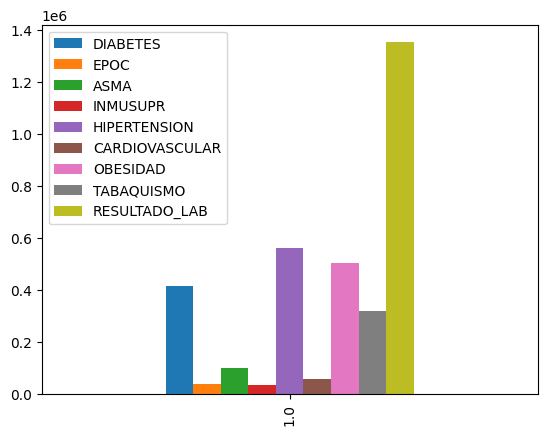

In [ ]:
#me va a dar una grafica de barras
df3.apply(pd.value_counts).plot.bar()

In [ ]:
#la informacion viene del dataframe original sin restricciones
#la base es hipertension y se van a comparar con todas las otras comorbilidades positivas
#solo considero las comorbilidades positivas (iguales a 1)
table = pd.pivot_table(data=df,index=['HIPERTENSION'], aggfunc=lambda x:(x==1).sum())
table

,ASMA,CARDIOVASCULAR,CLASIFICACION_FINAL,DIABETES,EDAD,EMBARAZO,ENTIDAD_NAC,ENTIDAD_RES,ENTIDAD_UM,EPOC,...,RENAL_CRONICA,RESULTADO_ANTIGENO,RESULTADO_LAB,SECTOR,SEXO,TABAQUISMO,TIPO_PACIENTE,TOMA_MUESTRA_ANTIGENO,TOMA_MUESTRA_LAB,UCI
HIPERTENSION,,,,,,,,,,,,,,,,,,,,,
1,17426,34318,10110,222861,34,794,7463,8622,8759,20905,...,36319,15812,253175,89,293276,46839,376307,51690,480098,14697
2,82553,26222,61178,195131,9627,29138,43374,48921,48884,19747,...,19048,116023,1096940,644,1703756,273416,2954859,486856,2608096,27047
98,61,68,803,283,15,40,74,57,56,38,...,53,85,3845,2,4683,150,9052,266,8755,439


In [ ]:
#solo quiero considerar datos que sean 1 o 2 (ya que no considero los que son 98)
dfs=df[df!=98]

In [ ]:
#se quiere ver la interaccion entre asma e hipertension
#total me va a permitir una suma automataica
pd.crosstab(dfs.ASMA,dfs.HIPERTENSION, margins=True, margins_name="Total")

HIPERTENSION,1.0,2.0,Total
ASMA,,,
1.0,17426,82553,99979
2.0,545363,3210306,3755669
Total,562789,3292859,3855648


<Axes: xlabel='ASMA'>

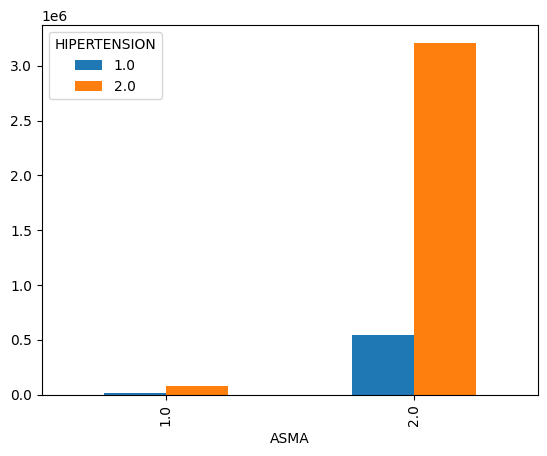

In [ ]:
#grafica de la misma tabla cruzada anterior
#eje x para el asma
#eje y para la hipertension
tabla = pd.crosstab(dfs.ASMA,dfs.HIPERTENSION)
tabla.plot(kind='bar')

In [ ]:
pd.crosstab(dfs.HIPERTENSION,[dfs.ASMA, dfs.OBESIDAD], margins=True, margins_name="Total")

ASMA            1.0            2.0             Total
OBESIDAD        1.0    2.0     1.0      2.0         
HIPERTENSION                                        
1.0            6857  10560  141508   403610   562535
2.0           14437  68105  341656  2867885  3292083
Total         21294  78665  483164  3271495  3854618

<Axes: xlabel='HIPERTENSION'>

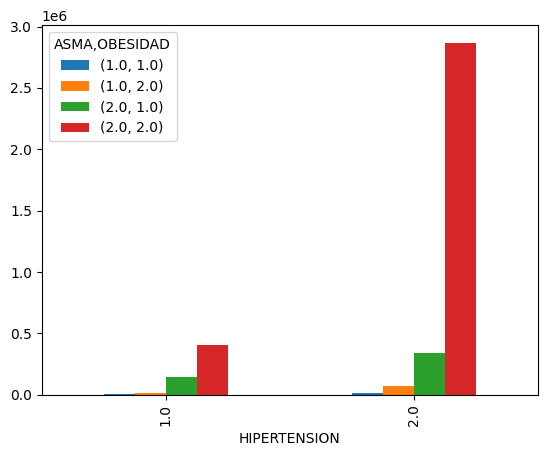

In [ ]:
#kind es tipo barra
tabla=pd.crosstab(dfs.HIPERTENSION,[dfs.ASMA,dfs.OBESIDAD])
tabla.plot(kind='bar',stacked=False)

In [27]:
#comportamiento por edad
import plotly.express as px
fig = px.histogram(dfedad, x="EDAD")
fig.show()

In [ ]:
#comportamiento por edad
import plotly.express as px
fig = px.histogram(dfedad, )

In [ ]:
#cuando no se sabe cuando la fecha fue mortal se pone un 99999999
#si es una fecha determinada, entonces es porque fallecio
#queremos ver como impacta con la edad
dfh=dfedad.query('RESULTADO_LAB ==1 & FECHA_DEF != "999-99-99"')
import plotly.express as px
fig = px.histogram(dfh, x="EDAD")
fig.show()